![nasdaq](https://www.livetradingnews.com/wp-content/uploads/2019/09/ixic.jpg)

## IPOs EUA

In [300]:
# Pega todos dados históricos de IPOS
url = 'https://api.nasdaq.com/api/quote/list-type-extended/ipo_performance?&limit=500&offset=0&sortColumn=symbol&sortOrder=asc'

In [428]:
from selenium import webdriver
from selenium.webdriver.common.keys import Keys
from selenium.webdriver.chrome.options import Options
import json
import numpy as np
import pandas as pd
import pandas_datareader as pdf
import matplotlib.pyplot as plt
import urllib
import time

In [309]:
WINDOW_SIZE = "1920,1080"
chrome_options = Options()
chrome_options.add_argument("--headless")
driver = webdriver.Chrome('D:/Aplicativos/chromedriver/chromedriver.exe',options=chrome_options)

<ipython-input-309-39a3cec99120>:4: DeprecationWarning: use options instead of chrome_options
  driver = webdriver.Chrome('D:/Aplicativos/chromedriver/chromedriver.exe',chrome_options=chrome_options)


In [314]:
driver.get(url)
content = driver.page_source
content = driver.find_element_by_tag_name('pre').text
parsed_json = json.loads(content)
# Fecha chrome
driver.quit()

In [68]:
# Tratamento básico
df = pd.DataFrame(parsed_json['data']['ipoTable']['table']['rows'])
df.columns = [col.lower() for col in df.columns]
df.index = pd.to_datetime(df.offerdate)
df.drop(columns=['url','offerdate'], inplace=True)
df=df.sort_index()

In [72]:
# Transforma textos para números
num_cols=['day1','day30','day60','month6','sinceoffer']
for col in num_cols:
    df[col] = pd.to_numeric(df[col].apply(lambda x:x.replace("%","").replace("+","")), errors='coerce')

In [73]:
# Retorno médio "desde a oferta" para IPOs realizados entre data de início e fim
df.sinceoffer.mean()

50.64135135135133

In [650]:
df.to_pickle('data/nasdaq')

In [104]:
start = df.iloc[0].name.date().isoformat()
end = df.iloc[-1].name.date().isoformat()
print(f'IPO mais antigo: {start} até \nIPO mais novo:   {end}')

IPO mais antigo: 2020-02-11 até 
IPO mais novo:   2021-02-04


In [115]:
sp = pdr.get_data_yahoo('^GSPC', start=start, end=end)
sp.columns = [col.lower() for col in sp.columns]

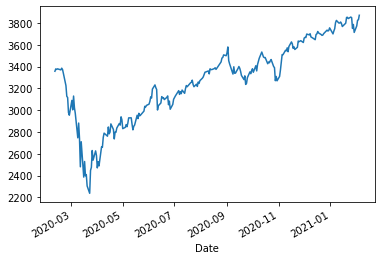

In [116]:
sp.close.plot()

In [651]:
sp.to_pickle('data/spx')

In [121]:
# Ganho do S&P 500 no mesmo período
(sp.iloc[-1]['adj close']/sp.iloc[0]['adj close']-1)*100

15.30757174400641

In [122]:
# IDEAL: COMPARAR ANOS ANTERIORES
# IDEAL: COMPARAR CADA AÇÃO VS. S&P

In [143]:
ano = df.index.year == 2020
mes = df.index.month.isin([1,2])
df[ano & mes]

,symbol,companyname,day1,day30,day60,month6,sinceoffer
offerdate,,,,,,,
2020-02-11,GNRSU,Greenrose Acquisition Corp.,0.70,-1.50,-2.90,NaN,25.50
2020-02-12,HUIZ,Huize Holding Ltd,-4.76,-21.33,-48.10,-17.81,-38.00
2020-02-13,GRIL,"Muscle Maker, Inc.",-22.80,-56.20,-66.40,-49.40,-53.60
2020-02-14,NBACU,Newborn Acquisition Corp,0.50,-1.00,-1.00,0.50,155.00
2020-02-20,ESSCU,East Stone Acquisition Corp,0.10,-5.00,-0.90,1.50,11.00
2020-02-24,ZCMD,Zhongchao Inc.,NaN,-39.50,-39.50,-45.50,-48.00
2020-02-28,PASG,"Passage BIO, Inc.",23.33,-30.39,1.89,-11.00,19.89


In [144]:
df[ano & mes].sinceoffer.mean()

10.255714285714287

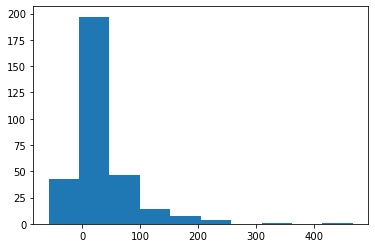

In [294]:
plt.hist(df.day30.dropna())
plt.show()

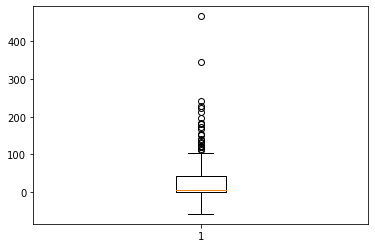

In [292]:
plt.boxplot(df.day30.dropna())
plt.show()

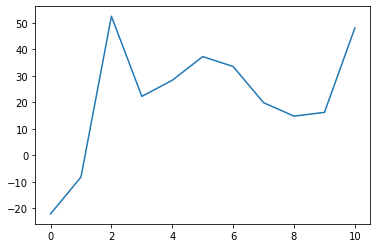

In [154]:
retorno_mes = []
for m in df.index.month.unique():
    retorno_mes.append(df[ano & (df.index.month == m)].day30.mean())
plt.plot(retorno_mes)

In [179]:
retorno_mes.pop() # remove o último elemento que é 'nan'

In [195]:
print(np.array(retorno_mes).std(), np.array(retorno_mes).mean())
'Desvio padrão e média'

21.2493951198416 22.037582056832054


'Desvio padrão e média'

In [181]:
media = sum(retorno_mes)/len(retorno_mes)
media # Retorno médio de ganho no 1º mês

22.037582056832058

In [189]:
df.day30.dropna().mean() # Ganho médio no primeiro mês das startus

27.185303514377004

In [188]:
gain6m = df.month6.dropna().mean()
gain6m # Ganho absoluto médio total em 6 meses

48.12022727272727

In [187]:
((gain6m/100+1)**(1/6)-1)*100 # Ganho médio mensal nos primeiros 6 meses

6.766677569058488

In [277]:
from sklearn.linear_model import LinearRegression as lr
X = ((df.index -  df.index[0]).days).values.reshape(-1, 1)
y = df.sinceoffer.values

reg = lr().fit(X, y.reshape(-1,1))

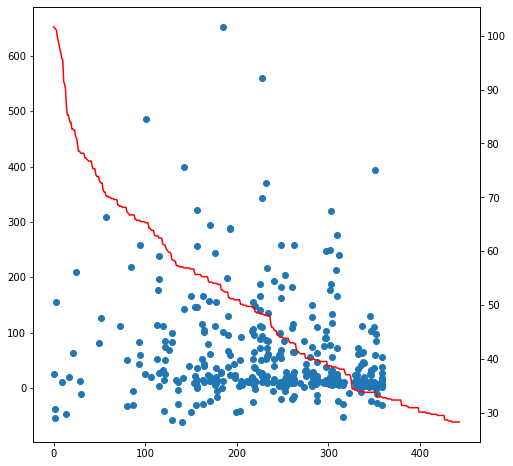

In [281]:
fig, ax = plt.subplots(figsize=(8,8))
ax.scatter(x=X,y=df.sinceoffer)
ax1 = ax.twinx()
ax1.plot(reg.predict(X), color="r")
plt.show()

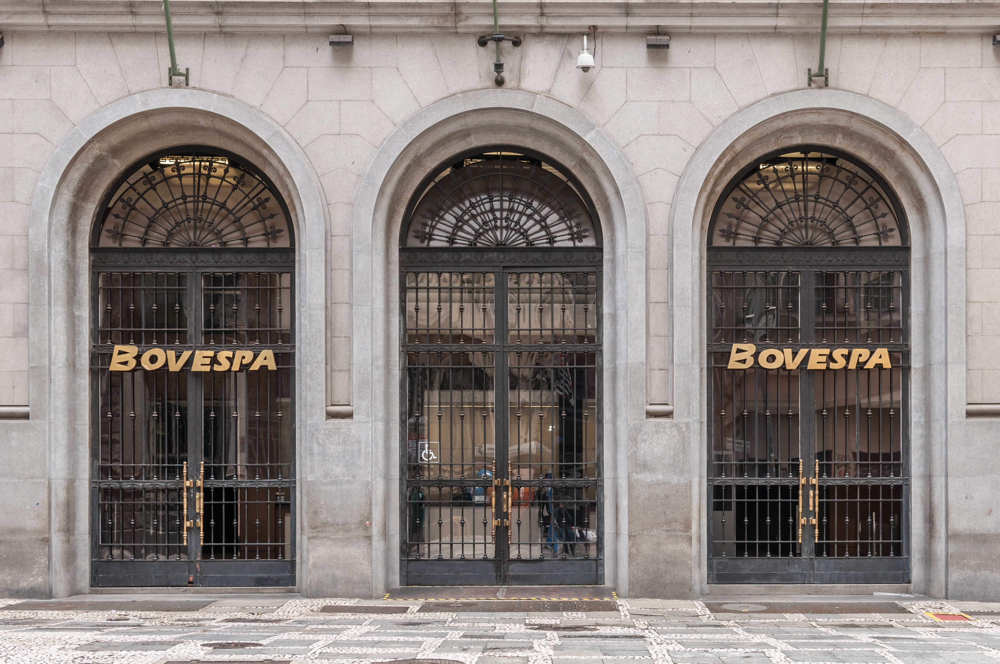

## IPOs BRASIL

In [449]:
# Investing.com ==> desisti
# from bs4 import BeautifulSoup as bs
# import requests as r

In [447]:
# inv = 'https://br.investing.com/ipo-calendar/'

In [446]:
# WINDOW_SIZE = "1920,1080"
# chrome_options = Options()
# chrome_options.add_argument("--headless")
# driver = webdriver.Chrome('D:/Aplicativos/chromedriver/chromedriver.exe',options=chrome_options)
# driver.get(inv)
# content = driver.page_source
# driver.quit()

In [445]:
# investing = bs(content, 'html.parser')
# tabela = investing.find('table',id="ipoCalendarData")
# investing_table = pd.read_html(tabela.prettify(), skiprows=0, flavor='bs4')[0]

In [444]:
# investing_table

#### Dados da B3

In [391]:
brasipos = pd.read_excel('http://www.b3.com.br/data/files/EB/A7/76/B2/A1477710DEA35577AC094EA8/Ofertas%20P%C3%BAblicas%20(Imprensa)%20-%20Janeiro.21%20(SITE).xlsx',
                         skiprows=1,
                         header=1,
                         skipfooter=6
                        )

In [392]:
brasipos = brasipos[brasipos['CLASSIFICAÇÃO']=='IPO'].copy()
brasipos.index = pd.to_datetime(brasipos['INÍCIO DE NEGOCIAÇÃO'])
try:
    brasipos.drop(columns=['Unnamed: 0','COORDENADOR LÍDER','LISTAGEM NA OFERTA','INÍCIO DE NEGOCIAÇÃO'], inplace=True)
except:
    pass


In [451]:
brasipos = brasipos[brasipos.index.year>=2016]
brasipos['NOME DE PREGÃO']

INÍCIO DE NEGOCIAÇÃO
2016-10-28          ALLIAR
2017-02-08          MOVIDA
2017-02-14       IHPARDINI
2017-04-11           AZUL¹
2017-07-20    CARREFOUR BR
2017-07-25      BIOTOSCANA
2017-07-31    IRBBRASIL RE
2017-07-31       OMEGA GER
2017-09-28           CAMIL
2017-12-18       BK BRASIL
2017-12-15    PETROBRAS BR
2018-04-23     INTERMEDICA
2018-04-25         HAPVIDA
2018-04-30     INTER BANCO
2019-04-17        CENTAURO
2019-06-28      NEOENERGIA
2019-10-10     VIVARA S.A.
2019-10-28       BANCO BMG
2019-10-28       CEA MODAS
2020-02-05    MITRE REALTY
2020-02-06         LOCAWEB
2020-02-13    MOURA DUBEUX
2020-02-17          PRINER
2020-05-15         ESTAPAR
2020-07-06        AURA 360
2020-07-13         AMBIPAR
2020-07-31      GRUPO SOMA
2020-08-10     D1000VFARMA
2020-08-10     QUERO-QUERO
2020-09-02           LAVVI
2020-09-02     PAGUE MENOS
2020-09-11            PETZ
2020-09-17     PLANOEPLANO
2020-09-28         MELNICK
2020-09-25      HIDROVIAS²
2020-09-21        CURY S/A
2020-09

In [452]:
# Busca os tickers no yahoo
yahoo = 'https://query2.finance.yahoo.com/v1/finance/search?'

In [453]:
# get_simb = []
# for cia in brasipos['NOME DE PREGÃO']:
#     lista_sim = r.get(yahoo + urllib.parse.urlencode({'q':cia})).text
#     lsim = json.loads(lista_sim)['quotes']
#     for el in lsim:
#         if el['exchange'] == 'SAO':
#             get_simb.append(el['symbol'])
#             break
#     time.sleep(2)
    
# simbolos = pd.DataFrame(get_simb)
# simbolos.columns=["simbolos"]

In [442]:
# !mkdir data

In [492]:
# simbolos

,simbolos
0,AALR3.SA
1,MOVI3.SA
2,PARD3.SA
3,AZUL4.SA
4,CRFB3.SA
5,IRBR3.SA
6,OMGE3.SA
7,CAML3.SA
8,BKBR3.SA
9,BRDT3.SA


In [494]:
# for sb in simbolos.values:
#     to_save = pdr.get_data_yahoo(sb[0])
#     to_save.to_csv(f'data/{sb[0]}.csv')
#     time.sleep(4)

In [653]:
simbolos.to_pickle('data/simbolos')

In [507]:
try:
    del base
except:
    pass 

for sb in simbolos.values:
    incr = pd.read_csv(f'data/{sb[0]}.csv').iloc[3:]
    incr.columns = [f'{col}.{sb[0]}' for col in incr.columns]
    incr.index = incr[f'Date.{sb[0]}']
    if 'base' not in globals():
        base = incr[f'Close.{sb[0]}']
    else:
        base = pd.concat([base, incr[f'Close.{sb[0]}']], axis=1)

In [508]:
base

,Close.AALR3.SA,Close.MOVI3.SA,Close.PARD3.SA,Close.AZUL4.SA,Close.CRFB3.SA,Close.IRBR3.SA,Close.OMGE3.SA,Close.CAML3.SA,Close.BKBR3.SA,Close.BRDT3.SA,...,Close.GMAT3.SA,Close.TFCO4.SA,Close.CASH3.SA,Close.ENJU3.SA,Close.AERI3.SA,Close.RRRP3.SA,Close.AVLL3.SA,Close.RDOR3.SA,Close.NGRD3.SA,Close.VAMO3.SA
2016-11-03,17.990000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-04,17.750000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-07,17.650000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-08,17.490000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-09,16.549999,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-02-03,11.500000,19.860001,22.379999,42.509998,19.639999,7.29,41.049999,11.42,9.93,22.990000,...,8.39,14.08,32.450001,19.000000,12.11,34.259998,22.820000,71.000000,8.87,NaN
2021-02-04,10.970000,19.730000,21.850000,43.369999,19.389999,7.12,41.599998,11.29,10.03,22.770000,...,8.61,13.80,34.099998,20.900000,11.97,34.000000,23.000000,73.400002,8.72,NaN
2021-02-05,11.120000,19.629999,22.030001,43.619999,19.639999,6.98,41.930000,11.51,10.17,22.610001,...,8.62,13.45,34.930000,19.770000,11.87,34.450001,23.000000,73.820000,8.39,32.509998
2021-02-08,10.800000,19.650000,21.799999,44.450001,19.709999,6.72,42.700001,11.19,10.23,22.340000,...,8.40,13.08,33.599998,18.299999,11.95,35.660000,23.389999,73.860001,8.03,34.410000


In [526]:
base.index = pd.to_datetime(base.index)
base

,Close.AALR3.SA,Close.MOVI3.SA,Close.PARD3.SA,Close.AZUL4.SA,Close.CRFB3.SA,Close.IRBR3.SA,Close.OMGE3.SA,Close.CAML3.SA,Close.BKBR3.SA,Close.BRDT3.SA,...,Close.GMAT3.SA,Close.TFCO4.SA,Close.CASH3.SA,Close.ENJU3.SA,Close.AERI3.SA,Close.RRRP3.SA,Close.AVLL3.SA,Close.RDOR3.SA,Close.NGRD3.SA,Close.VAMO3.SA
2016-11-03,17.990000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-04,17.750000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-07,17.650000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-08,17.490000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-09,16.549999,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-02-03,11.500000,19.860001,22.379999,42.509998,19.639999,7.29,41.049999,11.42,9.93,22.990000,...,8.39,14.08,32.450001,19.000000,12.11,34.259998,22.820000,71.000000,8.87,NaN
2021-02-04,10.970000,19.730000,21.850000,43.369999,19.389999,7.12,41.599998,11.29,10.03,22.770000,...,8.61,13.80,34.099998,20.900000,11.97,34.000000,23.000000,73.400002,8.72,NaN
2021-02-05,11.120000,19.629999,22.030001,43.619999,19.639999,6.98,41.930000,11.51,10.17,22.610001,...,8.62,13.45,34.930000,19.770000,11.87,34.450001,23.000000,73.820000,8.39,32.509998
2021-02-08,10.800000,19.650000,21.799999,44.450001,19.709999,6.72,42.700001,11.19,10.23,22.340000,...,8.40,13.08,33.599998,18.299999,11.95,35.660000,23.389999,73.860001,8.03,34.410000


In [630]:
from datetime import date

def get_gain(frame,delta=pd.DateOffset(days=30)):
    retornos = []
    for col in frame.columns:
        init_val = frame[col].dropna().iloc[0]
        day_fut = pd.to_datetime(frame[col].dropna().index[0]) + delta
        dfut_idx = frame.index.get_loc(day_fut, method='nearest')
        dfut_val = frame[col].iloc[dfut_idx]
        gain=(dfut_val/init_val-1)*100
        # print(init_val)
        # print(d30_idx)
        # print(gain)
        # print(d30_val)
        if day_fut>date.today(): # se o IPO é recente, pula para a próxim execução e não add o ganho
            continue
        retornos.append((col,round(gain,2)))
    return retornos

In [631]:
mes = pd.DateOffset(days=30)
ano = pd.DateOffset(days=365)

retornos = get_gain(base,delta=mes)
ret_30 = pd.DataFrame(retornos, columns=["ativo","retorno"])

In [632]:
ret_30.retorno.mean()

0.39333333333333237

In [633]:
ret_30.retorno.std()

20.39959758961391

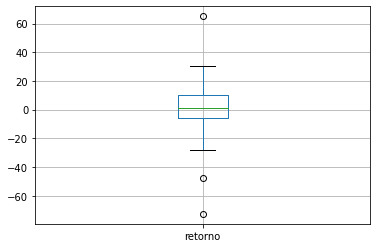

In [634]:
ret_30.boxplot()

In [654]:
base.to_pickle('data/brasil')

**CONCLUSÃO:**

NO BRASIL, NO PRIMEIRO MÊS, O RETORNO MÉDIO É APROXIMADAMENTE ZERO PARA OS IPOS, DE 2016 EM DIANTE

---

In [635]:
# Corte de 2019 em diante

recente = base[base.index.year>2018]

In [636]:
retornos = get_gain(recente,delta=mes)
rec_30 = pd.DataFrame(retornos, columns=["ativo","retorno"])

In [637]:
rec_30.retorno.mean()

1.7444444444444447

In [638]:
rec_30.retorno.median()

3.2

In [639]:
rec_30.retorno.std()

20.29620234915832

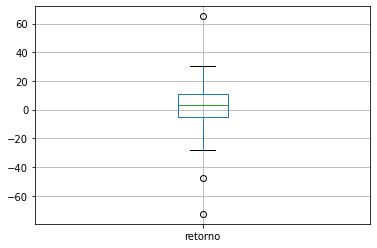

In [640]:
rec_30.boxplot()

#### Mudar para pós 2019 não ajuda muito.
---
#### Tentar ganho anual:

In [641]:
anual = get_gain(base,delta=ano)
ret_ano = pd.DataFrame(anual, columns=["ativo","retorno"])

In [642]:
ret_ano.retorno.mean()

21.69529411764706

In [643]:
ret_ano.retorno.median()

11.13

In [644]:
ret_ano.retorno.std()

50.2037636932789

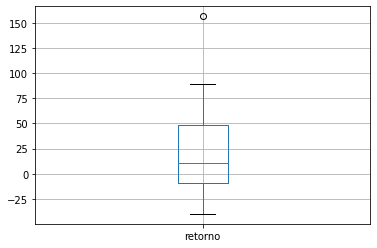

In [645]:
ret_ano.boxplot()